<a href="https://colab.research.google.com/github/ferhat00/notebook/blob/master/detecting_oil_storage_tanks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/ultralytics/yolov5.git  # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies
!pip install torch==1.6.0+cu101 torchvision==0.7.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

Cloning into 'yolov5'...
remote: Enumerating objects: 3650, done.
remote: Total 3650 (delta 0), reused 0 (delta 0), pack-reused 3650
Receiving objects: 100% (3650/3650), 7.08 MiB | 36.46 MiB/s, done.
Resolving deltas: 100% (2443/2443), done.
     |████████████████████████████████| 276kB 9.1MB/s 
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 708.0MB 26kB/s 
     |████████████████████████████████| 5.9MB 44.0MB/s 
  Found existing installation: torch 1.7.0+cu101
    Uninstalling torch-1.7.0+cu101:
      Successfully uninstalled torch-1.7.0+cu101
  Found existing installation: torchvision 0.8.1+cu101
    Uninstalling torchvision-0.8.1+cu101:
      Successfully uninstalled torchvision-0.8.1+cu101


In [2]:
import os
import shutil
import json
import ast
import numpy as np
from tqdm import tqdm
import pandas as  pd
from sklearn import model_selection
from IPython.display import Image
import matplotlib.pyplot as plt
import seaborn as sns
import fastai.vision as vision

In [3]:
 ! pip install -q kaggle

In [4]:
from google.colab import files

files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ferhat00","key":"059bdb3cf3fe1c518d8c5151cc4de106"}'}

In [5]:
! mkdir ~/.kaggle

! cp kaggle.json ~/.kaggle/

In [6]:
! chmod 600 ~/.kaggle/kaggle.json

In [7]:
!kaggle datasets list -s ["oil storage"]

ref                                                           title                                            size  lastUpdated          downloadCount  
------------------------------------------------------------  ----------------------------------------------  -----  -------------------  -------------  
towardsentropy/oil-storage-tanks                              Oil Storage Tanks                                 3GB  2019-06-05 04:28:33            907  
towardsentropy/oil-storage-tanks-annottionos                  Oil Storage Tanks Annotations                   287KB  2020-11-13 19:37:04              3  
meliao/gas-solid-collision-data                               Gas solid collision data                         24MB  2020-01-05 19:59:29             20  
new-york-state/nys-oil,-gas,-other-regulated-wells            NYS Oil, Gas, & Other Regulated Wells             3MB  2018-08-02 06:18:56            341  
new-york-state/nys-bulk-storage-facilities-in-new-york-state  NYS Bulk Stora

In [8]:
! kaggle datasets download 'towardsentropy/oil-storage-tanks'

100% 3.36G/3.37G [00:59<00:00, 48.0MB/s]
100% 3.37G/3.37G [01:00<00:00, 60.1MB/s]


In [9]:
! mkdir 'oil-storage-tanks'

! unzip oil-storage-tanks.zip -d ../oil-storage-tanks/

Streaming output truncated to the last 5000 lines.
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_0_3.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_0_4.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_0_5.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_0_6.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_0_7.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_0_8.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_0_9.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_1_0.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_1_1.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_1_2.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/image_patches/51_1_3.jpg  
  inflating: ../oil-storage-tanks/oil tanks/Oil Tanks/imag

In [10]:
DATA_PATH = '../oil-storage-tanks/Oil Tanks'
os.listdir(DATA_PATH)
#os.listdir()

['large_image_data.csv',
 'large_images',
 'labels.json',
 'image_patches',
 'labels_coco.json']

In [11]:
def conv_bbox(box_dict):
    
    xs = np.array(list(set([i['x'] for i in box_dict])))
    ys = np.array(list(set([i['y'] for i in box_dict])))
    
    x_min = xs.min()
    x_max = xs.max()
    y_min = ys.min()
    y_max = ys.max()
    
    return y_min, x_min, y_max, x_max

In [12]:
source = os.path.join(DATA_PATH,'image_patches')
destination_1 = 'train' #Train images(only tank containing images)
destination_2 = 'test' #Test images

if not os.path.isdir(destination_1):
    os.mkdir(destination_1)
if not os.path.isdir(destination_2):
    os.mkdir(destination_2)
label_to_num = {'Tank': 0, 'Tank Cluster': 1, 'Floating Head Tank': 2}

annotations = []

json_labels = json.load(open(os.path.join(DATA_PATH,'labels.json')))
for i in tqdm(range(len(json_labels))):
    file = json_labels[i]['file_name']
    if(file.startswith('01')):
        shutil.copy(source+'/'+file,destination_2)
    elif(json_labels[i]['label']!='Skip'):  
        shutil.copy(source+'/'+file,destination_1)
        for label in json_labels[i]['label'].keys():
            for box in json_labels[i]['label'][label]:
                y_min, x_min, y_max, x_max = conv_bbox(box['geometry'])
                width = x_max - x_min
                height = y_max - y_min
                annotations.append((file.split('.')[0] ,label_to_num[label], label, [x_min, y_min, width, height]))

annotations = pd.DataFrame(annotations, columns=['image_name', 'class', 'class_name', 'bbox'])
print('Number of train images: ', len(os.listdir(destination_1)))
print('Number of test images: ', len(os.listdir(destination_2)))
print('Number of Annotated Tanks: ', len(annotations))
print(annotations[20:30])

100%|██████████| 10000/10000 [00:02<00:00, 3856.55it/s]


Number of train images:  1761
Number of test images:  100
Number of Annotated Tanks:  8496
   image_name  class class_name                bbox
20     02_1_7      0       Tank    [126, 2, 68, 58]
21     02_1_7      0       Tank   [263, 51, 31, 28]
22     02_1_7      0       Tank   [262, 84, 32, 31]
23     02_1_7      0       Tank   [320, 26, 41, 39]
24     02_1_7      0       Tank   [322, 71, 40, 40]
25     02_1_7      0       Tank   [419, 16, 87, 79]
26     02_1_7      0       Tank  [286, 194, 34, 29]
27     02_1_7      0       Tank  [304, 299, 22, 22]
28     02_1_7      0       Tank  [339, 299, 23, 23]
29     02_1_7      0       Tank  [378, 284, 27, 23]


In [13]:
df_train, df_valid= model_selection.train_test_split(
    annotations, 
    test_size=0.1, 
    random_state=42, 
    shuffle=True, 
    stratify = annotations['class']
)
df_train.shape, df_valid.shape

((7646, 4), (850, 4))

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


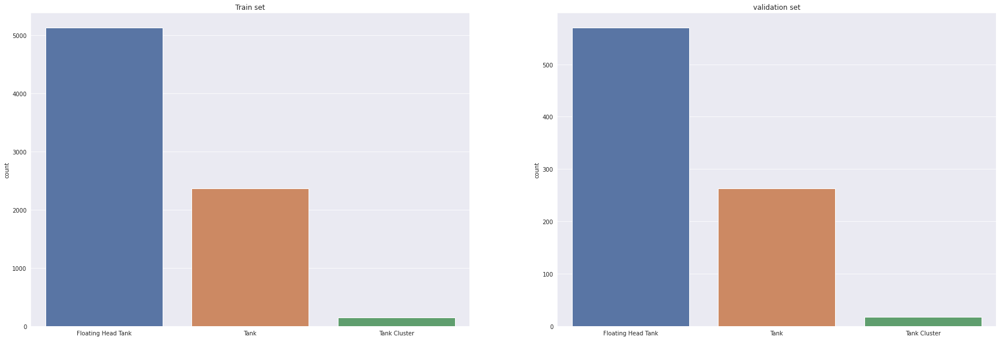

In [14]:
sns.set({'figure.figsize':(30,10)})
plt.subplot(1,2,1)
ax = sns.countplot(sorted(df_train['class_name']))
ax.set_title('Train set')

plt.subplot(1,2,2)
ax = sns.countplot(sorted(df_valid['class_name']))
ax.set_title('validation set')
plt.show()

In [15]:
def convert(data, data_type):
    df = data.groupby('image_name')['bbox'].apply(list).reset_index(name='bboxes')
    df['classes'] = data.groupby('image_name')['class'].apply(list).reset_index(drop=True)
    df.to_csv(data_type + '.csv', index=False)
    print(data_type)
    print(df.shape)
    print(df.head())

df_train = convert(df_train, 'train')
df_valid = convert(df_valid, 'validation')

train
(1720, 3)
  image_name  ...                         classes
0     02_0_7  ...                          [0, 0]
1     02_0_8  ...              [0, 0, 0, 0, 0, 0]
2     02_1_5  ...                          [0, 0]
3     02_1_6  ...     [0, 0, 0, 2, 0, 0, 0, 0, 0]
4     02_1_7  ...  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

[5 rows x 3 columns]
validation
(565, 3)
  image_name                                    bboxes classes
0     02_0_7                      [[321, 501, 38, 11]]     [0]
1     02_1_7                       [[262, 84, 32, 31]]     [0]
2     02_2_0                      [[286, 439, 61, 61]]     [0]
3     02_2_3  [[441, 417, 70, 95], [196, 289, 91, 92]]  [2, 2]
4     02_2_6                      [[257, 493, 34, 19]]     [0]


In [16]:
%cd yolov5
!ls

/content/yolov5
data	    hubconf.py	README.md	  train.py	  weights
detect.py   LICENSE	requirements.txt  tutorial.ipynb
Dockerfile  models	test.py		  utils


In [17]:
!mkdir tank_data
%cd tank_data

/content/yolov5/tank_data


In [18]:
!mkdir images
!mkdir labels
%cd images
!mkdir train
!mkdir validation
%cd ..
%cd labels
!mkdir train
!mkdir validation
%cd ..
%cd ..
%cd ..

/content/yolov5/tank_data/images
/content/yolov5/tank_data
/content/yolov5/tank_data/labels
/content/yolov5/tank_data
/content/yolov5
/content


In [19]:
for root,dir,_ in os.walk('yolov5/tank_data'):
    print(root)
    print(dir)

yolov5/tank_data
['labels', 'images']
yolov5/tank_data/labels
['validation', 'train']
yolov5/tank_data/labels/validation
[]
yolov5/tank_data/labels/train
[]
yolov5/tank_data/images
['validation', 'train']
yolov5/tank_data/images/validation
[]
yolov5/tank_data/images/train
[]


In [20]:
!dir '/content/yolov5/tank_data/labels/train'

In [21]:
INPUT_PATH = '/content/'
OUTPUT_PATH = '/content/yolov5/tank_data/'
def process_data(data, data_type='train'):
    for _, row in tqdm(data.iterrows(), total = len(data)):
        image_name = row['image_name']
        bounding_boxes = row['bboxes']
        classes = row['classes']
        yolo_data = []
        for bbox, Class in zip(bounding_boxes, classes):
            x = bbox[0]
            y = bbox[1]
            w = bbox[2]
            h = bbox[3]
            x_center = x + w / 2
            y_center = y + h / 2
            
            x_center /= 512
            y_center /= 512
            w /= 512
            h /= 512
            yolo_data.append([Class, x_center, y_center, w, h])
        yoy_data = np.array(yolo_data)
        np.savetxt(
            os.path.join(OUTPUT_PATH, f"labels/{data_type}/{image_name}.txt"),
            yolo_data,
            fmt = ["%d", "%f", "%f", "%f", "%f"]
        )
        shutil.copyfile(
            os.path.join(INPUT_PATH, f"train/{image_name}.jpg"),
            os.path.join(OUTPUT_PATH, f"images/{data_type}/{image_name}.jpg")
        )
  
df_train = pd.read_csv('/content/train.csv')
df_train.bboxes = df_train.bboxes.apply(ast.literal_eval)
df_train.classes = df_train.classes.apply(ast.literal_eval)

df_valid = pd.read_csv('/content/validation.csv')
df_valid.bboxes = df_valid.bboxes.apply(ast.literal_eval)
df_valid.classes = df_valid.classes.apply(ast.literal_eval)

process_data(df_train, data_type='train')
process_data(df_valid, data_type='validation')

100%|██████████| 565/565 [00:00<00:00, 1568.23it/s]


In [22]:
for root,dir,file in os.walk('/content/yolov5/tank_data/'):
    print(root)
    print(dir)
    print(file)

/content/yolov5/tank_data/
['labels', 'images']
[]
/content/yolov5/tank_data/labels
['validation', 'train']
[]
/content/yolov5/tank_data/labels/validation
[]
['04_2_4.txt', '91_1_8.txt', '42_5_8.txt', '05_1_9.txt', '97_7_4.txt', '30_5_6.txt', '83_6_7.txt', '61_4_5.txt', '38_1_7.txt', '22_5_2.txt', '08_9_6.txt', '08_7_7.txt', '08_8_5.txt', '06_2_5.txt', '27_5_1.txt', '79_0_6.txt', '78_8_4.txt', '07_8_4.txt', '59_8_7.txt', '02_7_0.txt', '14_2_2.txt', '28_7_5.txt', '05_3_2.txt', '03_2_8.txt', '86_8_0.txt', '94_8_6.txt', '15_6_3.txt', '40_3_8.txt', '30_5_4.txt', '07_3_7.txt', '83_7_3.txt', '06_2_9.txt', '65_6_6.txt', '06_5_9.txt', '84_6_2.txt', '41_4_5.txt', '39_5_3.txt', '30_3_5.txt', '21_0_4.txt', '89_1_1.txt', '20_3_5.txt', '66_5_5.txt', '31_4_6.txt', '26_4_5.txt', '69_0_4.txt', '92_2_5.txt', '05_6_2.txt', '07_7_4.txt', '59_5_6.txt', '08_1_5.txt', '46_4_3.txt', '42_2_3.txt', '05_8_9.txt', '85_6_6.txt', '21_5_6.txt', '21_1_2.txt', '05_4_8.txt', '06_7_0.txt', '76_7_7.txt', '25_2_2.txt', '

In [23]:
f = open('/content/yolov5/tank_data/labels/train/'+os.listdir("/content/yolov5/tank_data/labels/train/")[0]) 
print(f.name)
for l in f:
    print(l)

/content/yolov5/tank_data/labels/train/78_6_1.txt
2 0.867188 0.897461 0.238281 0.208984

2 0.957031 0.666016 0.085938 0.214844



In [24]:
%cd yolov5

/content/yolov5


In [25]:
%%writefile tank.yaml

train: tank_data/images/train
val: tank_data/images/validation
nc: 3
names: ['Tank','Tank Cluster','Floating Head Tank']

Writing tank.yaml


In [26]:
!ls

data	    hubconf.py	README.md	  tank.yaml  tutorial.ipynb
detect.py   LICENSE	requirements.txt  test.py    utils
Dockerfile  models	tank_data	  train.py   weights


In [27]:
%cd models
!ls

/content/yolov5/models
common.py	 export.py  __init__.py  yolov5l.yaml  yolov5s.yaml
experimental.py  hub	    yolo.py	 yolov5m.yaml  yolov5x.yaml


In [28]:
%cd ..
!ls

/content/yolov5
data	    hubconf.py	README.md	  tank.yaml  tutorial.ipynb
detect.py   LICENSE	requirements.txt  test.py    utils
Dockerfile  models	tank_data	  train.py   weights


In [29]:
!python train.py --img 512 --batch 16 --epochs 10 --data tank.yaml --cfg models/yolov5l.yaml --name oiltank
#!python train.py --img 512 --batch 16 --epochs 100 --data tank.yaml --cfg models/yolov5l.yaml --name oiltank

Using torch 1.6.0+cu101 CUDA:0 (Tesla T4, 15079.75MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=False, cfg='models/yolov5l.yaml', data='tank.yaml', device='', epochs=10, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[512, 512], local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='oiltank', noautoanchor=False, nosave=False, notest=False, project='runs/train', rect=False, resume=False, save_dir='runs/train/oiltank', single_cls=False, sync_bn=False, total_batch_size=16, weights='yolov5s.pt', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
2020-12-28 11:18:03.562989: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'warmup_bias_lr

In [31]:
print(os.listdir('/content/yolov5/runs/train/oiltank/'))

['results.png', 'hyp.yaml', 'train_batch2.jpg', 'confusion_matrix.png', 'results.txt', 'test_batch2_labels.jpg', 'labels_correlogram.jpg', 'precision_recall_curve.png', 'test_batch0_labels.jpg', 'train_batch1.jpg', 'weights', 'test_batch2_pred.jpg', 'test_batch0_pred.jpg', 'labels.jpg', 'test_batch1_pred.jpg', 'events.out.tfevents.1609154286.b7a20b188433.255.0', 'train_batch0.jpg', 'test_batch1_labels.jpg', 'opt.yaml']


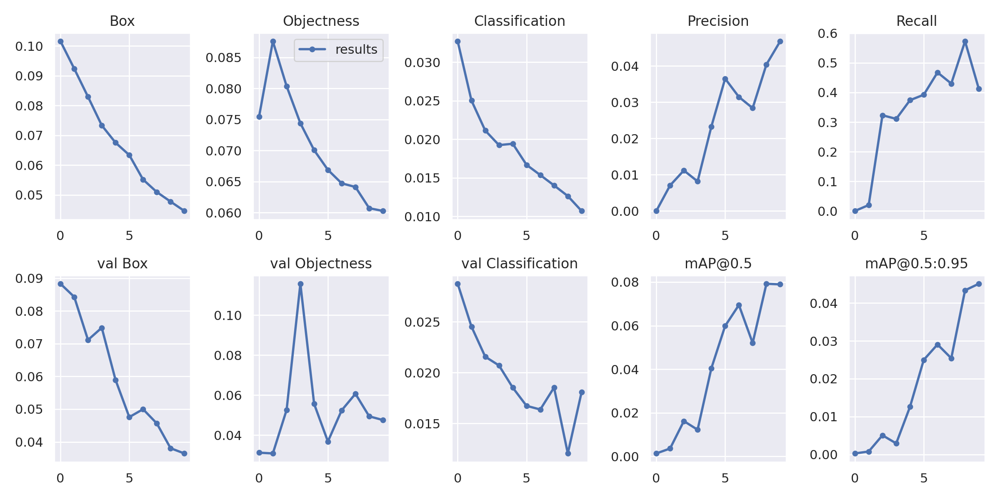

In [32]:
Image(filename='/content/yolov5/runs/train/oiltank/results.png', width=900)

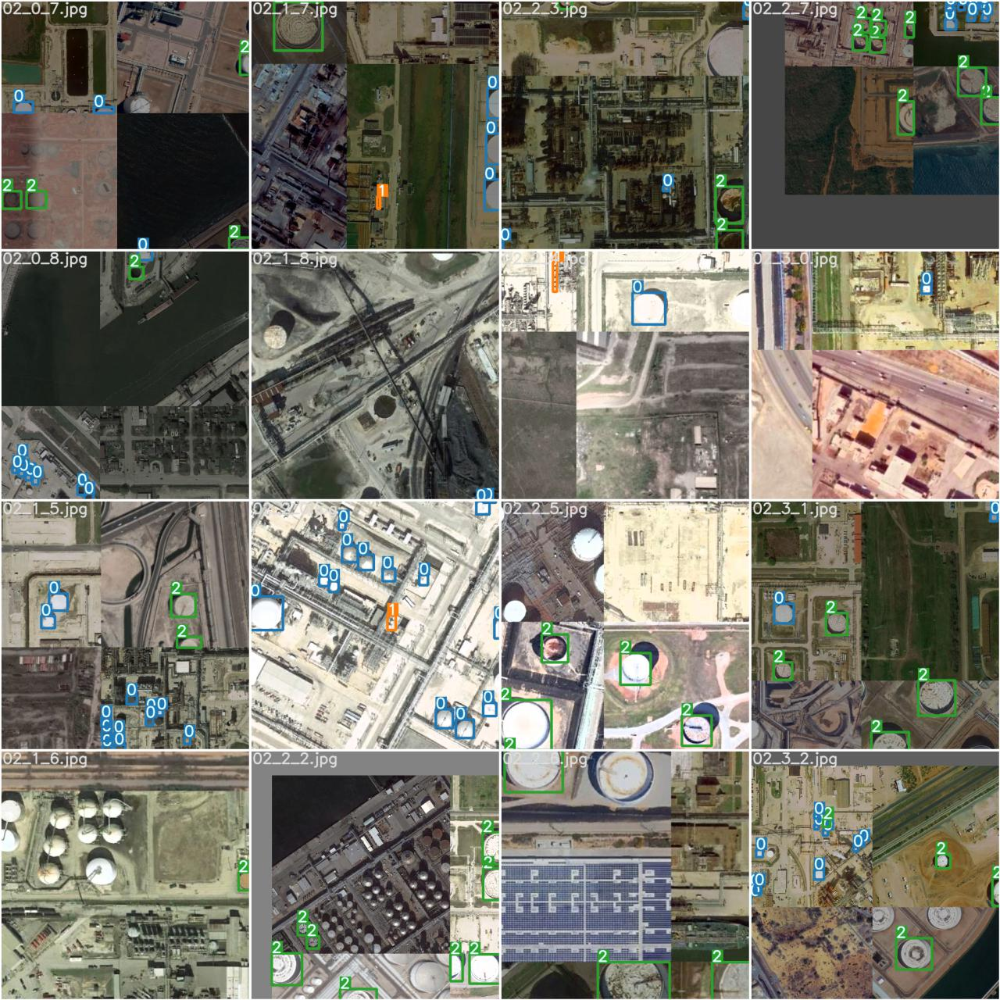

In [33]:
Image(filename='/content/yolov5/runs/train/oiltank/train_batch0.jpg', width=900)

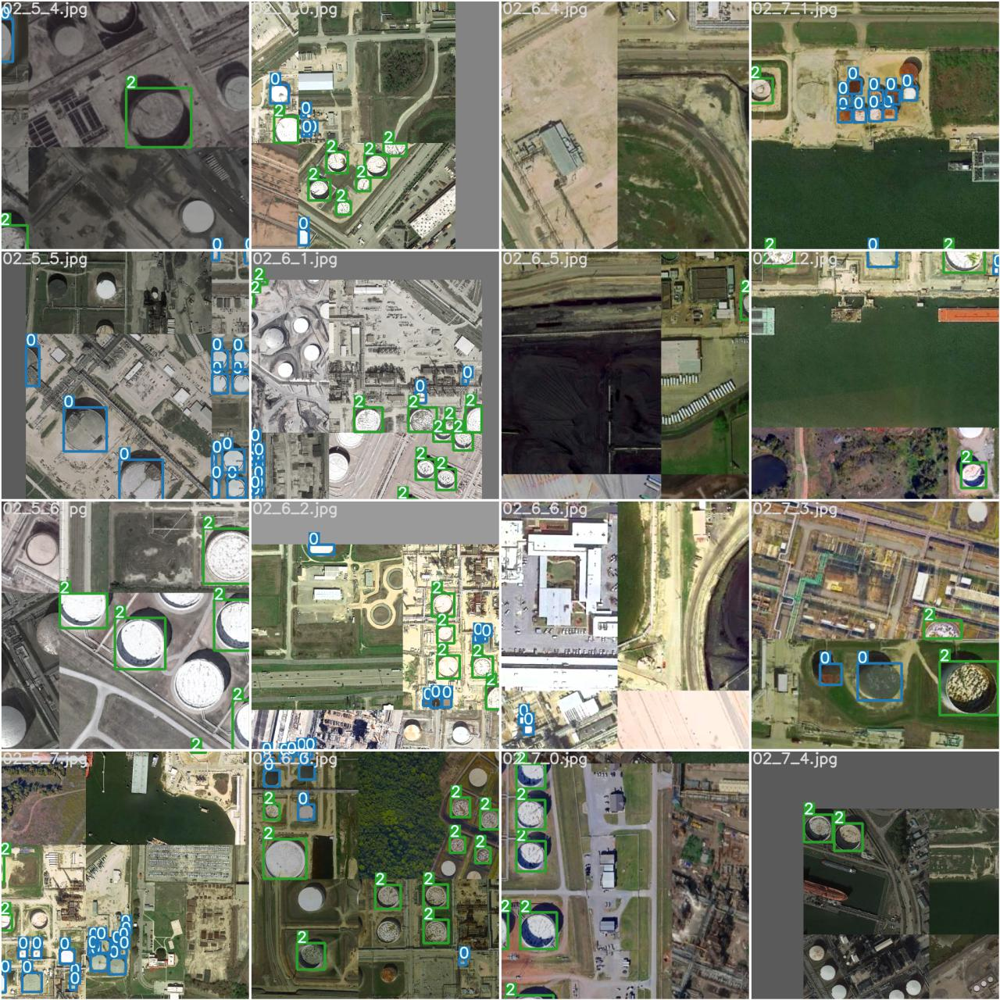

In [34]:
Image(filename='/content/yolov5/runs/train/oiltank/train_batch2.jpg', width=900)

In [38]:
!python detect.py --source /content/test/ --weight /content/yolov5/runs/train/oiltank/weights/best.pt

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.25, device='', exist_ok=False, img_size=640, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='/content/test/', update=False, view_img=False, weights=['/content/yolov5/runs/train/oiltank/weights/best.pt'])
Using torch 1.6.0+cu101 CUDA:0 (Tesla T4, 15079.75MB)

Fusing layers... 
Model Summary: 400 layers, 47375432 parameters, 0 gradients, 115.8 GFLOPS
image 1/100 /content/test/01_0_0.jpg: 640x640 Done. (0.034s)
image 2/100 /content/test/01_0_1.jpg: 640x640 1 Floating Head Tanks, Done. (0.035s)
image 3/100 /content/test/01_0_2.jpg: 640x640 3 Floating Head Tanks, Done. (0.035s)
image 4/100 /content/test/01_0_3.jpg: 640x640 1 Floating Head Tanks, Done. (0.022s)
image 5/100 /content/test/01_0_4.jpg: 640x640 2 Floating Head Tanks, Done. (0.022s)
image 6/100 /content/test/01_0_5.jpg: 640x640 2 Floating Head Tanks, Done. (0.022s)
image 7/100 /content/test/01_0_6.jpg: 640x640 1 Floa

In [41]:
print(sorted(os.listdir('/content/yolov5/runs/detect/exp4/')))

['01_0_0.jpg', '01_0_1.jpg', '01_0_2.jpg', '01_0_3.jpg', '01_0_4.jpg', '01_0_5.jpg', '01_0_6.jpg', '01_0_7.jpg', '01_0_8.jpg', '01_0_9.jpg', '01_1_0.jpg', '01_1_1.jpg', '01_1_2.jpg', '01_1_3.jpg', '01_1_4.jpg', '01_1_5.jpg', '01_1_6.jpg', '01_1_7.jpg', '01_1_8.jpg', '01_1_9.jpg', '01_2_0.jpg', '01_2_1.jpg', '01_2_2.jpg', '01_2_3.jpg', '01_2_4.jpg', '01_2_5.jpg', '01_2_6.jpg', '01_2_7.jpg', '01_2_8.jpg', '01_2_9.jpg', '01_3_0.jpg', '01_3_1.jpg', '01_3_2.jpg', '01_3_3.jpg', '01_3_4.jpg', '01_3_5.jpg', '01_3_6.jpg', '01_3_7.jpg', '01_3_8.jpg', '01_3_9.jpg', '01_4_0.jpg', '01_4_1.jpg', '01_4_2.jpg', '01_4_3.jpg', '01_4_4.jpg', '01_4_5.jpg', '01_4_6.jpg', '01_4_7.jpg', '01_4_8.jpg', '01_4_9.jpg', '01_5_0.jpg', '01_5_1.jpg', '01_5_2.jpg', '01_5_3.jpg', '01_5_4.jpg', '01_5_5.jpg', '01_5_6.jpg', '01_5_7.jpg', '01_5_8.jpg', '01_5_9.jpg', '01_6_0.jpg', '01_6_1.jpg', '01_6_2.jpg', '01_6_3.jpg', '01_6_4.jpg', '01_6_5.jpg', '01_6_6.jpg', '01_6_7.jpg', '01_6_8.jpg', '01_6_9.jpg', '01_7_0.jpg', '01_7

In [42]:
path = '/content/'
def plot_BBox(img_name, ax):
    sns.set({'figure.figsize':(20,10)})
    img_path = os.path.join(path+'test', img_name)
    image = vision.open_image(img_path)
    image.show(ax=ax, title = 'Ground Truth '+img_name)

    no,row,col = map(int,img_name.split('.')[0].split('_'))
    img_id = (no-1)*100 + row*10 + col

    idx = -1
    bboxes = []
    labels = []
    classes = []
    if(json_labels[img_id]['label'] != 'Skip'):
        for label in json_labels[img_id]['label'].keys():
            for box in json_labels[img_id]['label'][label]:
                bboxes.append(conv_bbox(box['geometry']))
                classes.append(label)
        labels = list(range(len(classes)))
        idx = 1
            
    if(idx!=-1):
        BBox = vision.ImageBBox.create(*image.size, bboxes, labels, classes)
        image.show(y=BBox, ax=ax)

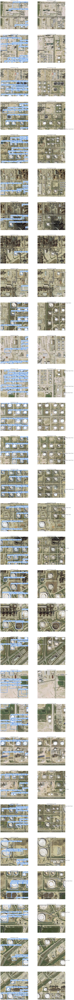

In [43]:
sns.set({'figure.figsize':(20,30*10)})
fig, ax = plt.subplots(30, 2)
for i, img_f in enumerate(sorted(os.listdir('/content/yolov5/runs/detect/exp4/'))[40:70]):
    image = vision.open_image('/content/yolov5/runs/detect/exp4/'+img_f)
    image.show(ax=ax[i][0], title= 'Predicted '+img_f)
    plot_BBox(img_f, ax[i][1])
plt.show()